<a href="https://colab.research.google.com/github/Toneeiei/beans/blob/main/Bean_here!!_beans_classification_using_CNN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Slide
https://www.canva.com/design/DAF0tBOqVno/KyOPjGto5mdwR6uoa-C_oQ/edit?utm_content=DAF0tBOqVno&utm_campaign=designshare&utm_medium=link2&utm_source=sharebutton

# import data set and libs


In [ ]:
!pip install -q datasets

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 521.2/521.2 kB 9.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.3/115.3 kB 16.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 19.2 MB/s eta 0:00:00


In [ ]:
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import tensorflow as tf
import seaborn as sns

# Dataset from link

In [ ]:
from datasets import load_dataset
dataset = load_dataset('beans')

Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split:   0%|          | 0/1034 [00:00<?, ? examples/s]

Generating validation split:   0%|          | 0/133 [00:00<?, ? examples/s]

Generating test split:   0%|          | 0/128 [00:00<?, ? examples/s]

In [ ]:
train = dataset['train']
validation = dataset['validation']
test = dataset['test']

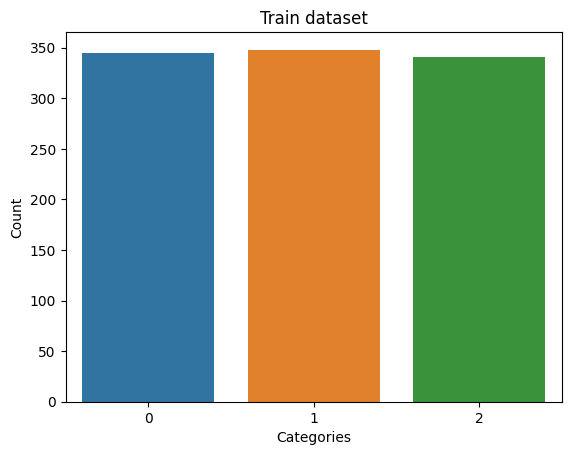

In [ ]:
train_set = train.to_pandas()
val_set = validation.to_pandas()
test_set = test.to_pandas()

sns.barplot(x=['0', '1', '2'], y=[len(train_set[train_set['labels']==0]),
                                  len(train_set[train_set['labels']==1]),
                                  len(train_set[train_set['labels']==2])])
# Add labels and title
plt.xlabel('Categories')
plt.ylabel('Count')
plt.title('Train dataset')

# Show the plot
plt.show()

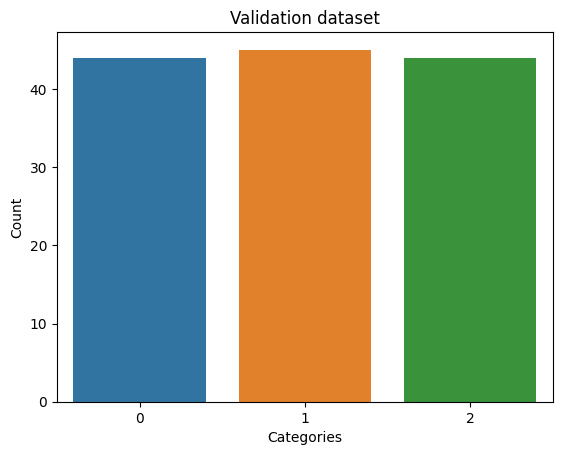

In [ ]:
sns.barplot(x=['0', '1', '2'], y=[len(val_set[val_set['labels']==0]),
                                  len(val_set[val_set['labels']==1]),
                                  len(val_set[val_set['labels']==2])])
# Add labels and title
plt.xlabel('Categories')
plt.ylabel('Count')
plt.title('Validation dataset')

# Show the plot
plt.show()

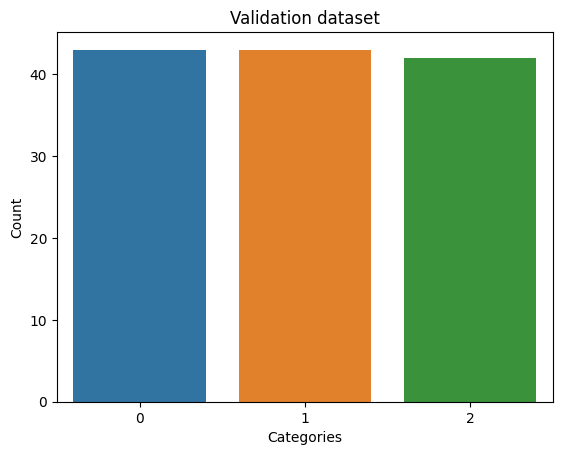

In [ ]:
sns.barplot(x=['0', '1', '2'], y=[len(test_set[test_set['labels']==0]),
                                  len(test_set[test_set['labels']==1]),
                                  len(test_set[test_set['labels']==2])])
# Add labels and title
plt.xlabel('Categories')
plt.ylabel('Count')
plt.title('Validation dataset')

# Show the plot
plt.show()

In [ ]:
height, width = 224, 224
channels = 3

num_samples = len(train['image_file_path'])

train_images = np.empty((num_samples, height, width, channels), dtype=np.float32)

train_labels = np.array(train['labels'])

# Load and preprocess each image
for i, path in enumerate(train['image_file_path']):
    img = Image.open(path)

    # Resize the image to your desired dimensions
    img_array = img.resize((height, width))

    img_array = np.array(img_array)

    # Normalize pixel values to the range [0, 1]
    normalized_img_array = img_array / 255.0

    # Assign the normalized array to the training images array
    train_images[i] = normalized_img_array
train_images = np.array(train_images)
# Ensure your train_images and train_labels arrays have the correct shape
print(train_images.shape)
print(type(train_images))


(1034, 224, 224, 3)
<class 'numpy.ndarray'>


In [ ]:
num_samples = len(validation['image_file_path'])

validation_images = np.empty((num_samples, height, width, channels), dtype=np.float32)

validation_labels = np.array(validation['labels'])

# Load and preprocess each image
for i, path in enumerate(validation['image_file_path']):
    img = Image.open(path)

    # Resize the image to your desired dimensions
    img_array = img.resize((height, width))

    img_array = np.array(img_array)

    # Normalize pixel values to the range [0, 1]
    normalized_img_array = img_array / 255.0

    # Assign the normalized array to the training images array
    validation_images[i] = normalized_img_array
validation_images = np.array(validation_images)
# Ensure your train_images and train_labels arrays have the correct shape
print(validation_images.shape)

(133, 224, 224, 3)


In [ ]:
num_samples = len(test['image_file_path'])

test_images = np.empty((num_samples, height, width, channels), dtype=np.float32)

test_labels = np.array(test['labels'])

# Load and preprocess each image
for i, path in enumerate(test['image_file_path']):
    img = Image.open(path)

    # Resize the image to your desired dimensions
    img_array = img.resize((height, width))

    img_array = np.array(img_array)

    # Normalize pixel values to the range [0, 1]
    normalized_img_array = img_array / 255.0

    # Assign the normalized array to the training images array
    test_images[i] = normalized_img_array
test_images = np.array(test_images)
# Ensure your train_images and train_labels arrays have the correct shape
print(test_images.shape)

(128, 224, 224, 3)


# See image

In [ ]:
from IPython.display import display

In [ ]:
# train image to show
image_train = []
image_val = []
image_test = []
for image_file_path in train['image_file_path']:
  image = Image.open(image_file_path)
  image_train.append(image)

for image_file_path in validation['image_file_path']:
  image = Image.open(image_file_path)
  image_val.append(image)

for image_file_path in test['image_file_path']:
  image = Image.open(image_file_path)
  image_test.append(image)

train_df = pd.DataFrame({"image": image_train, "label": train['labels']})
val_df = pd.DataFrame({"image": image_val, "label": validation['labels']})
test_df = pd.DataFrame({"image": image_test, "label": test['labels']})

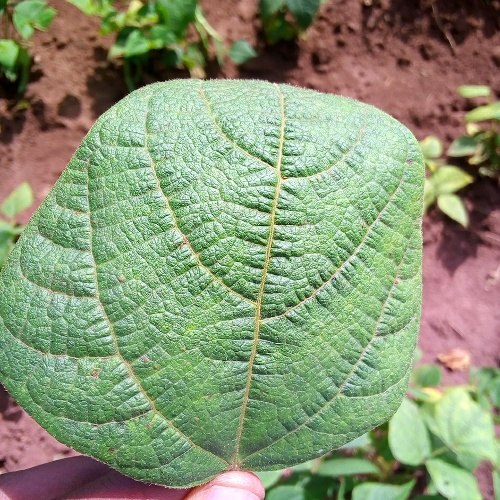

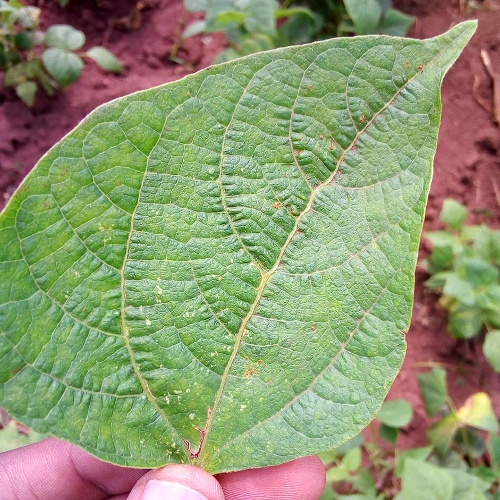

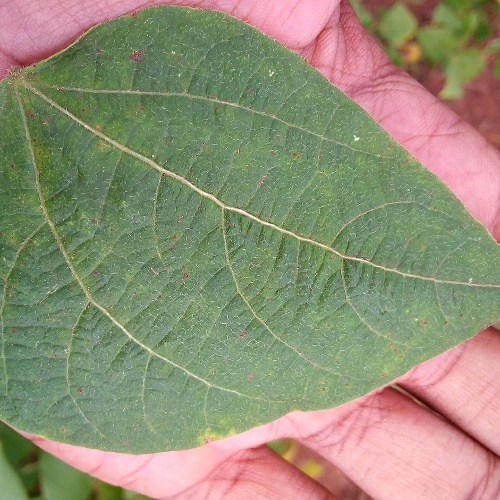

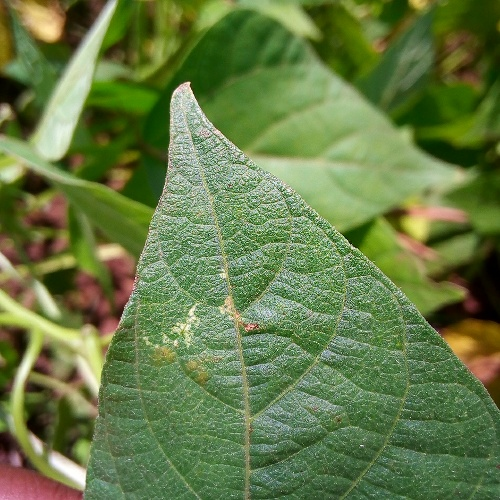

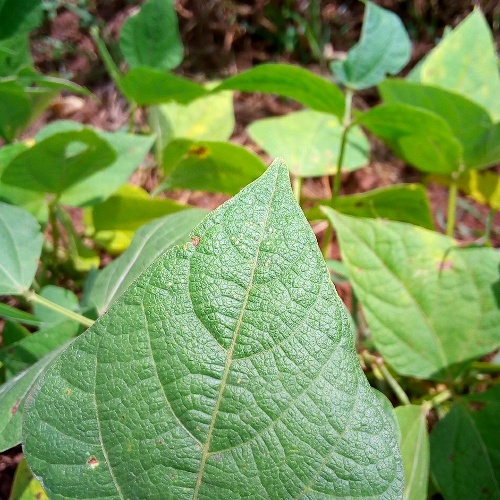

...

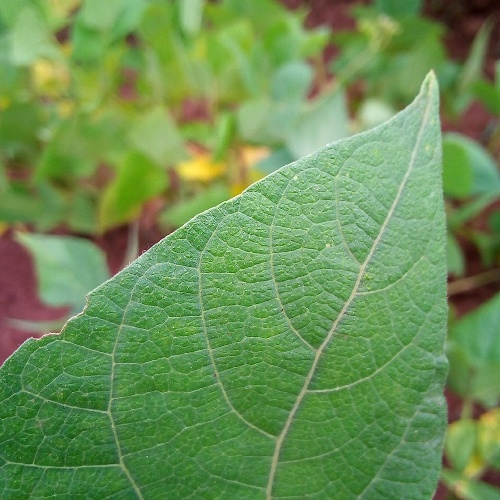

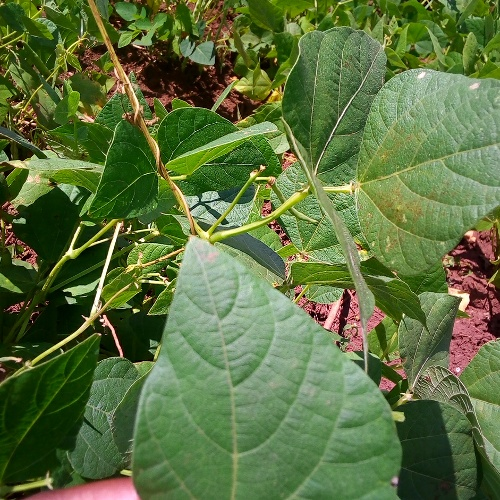

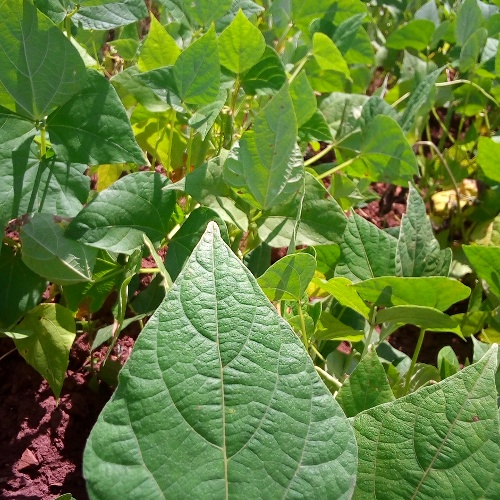

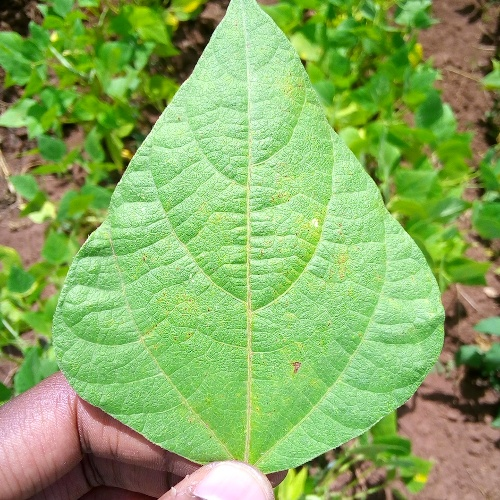

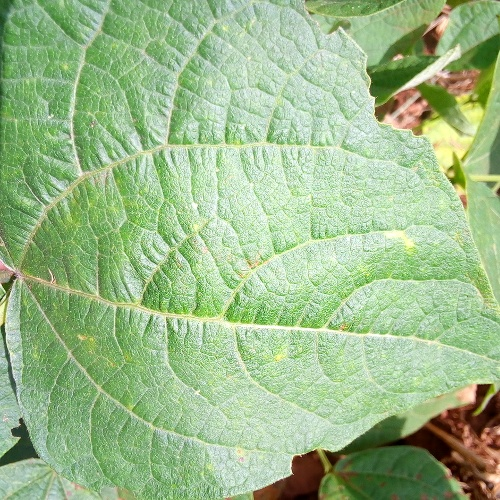

In [ ]:
from IPython.display import display
for im in test_df[test_df['label']==2]['image']:
  display(im)

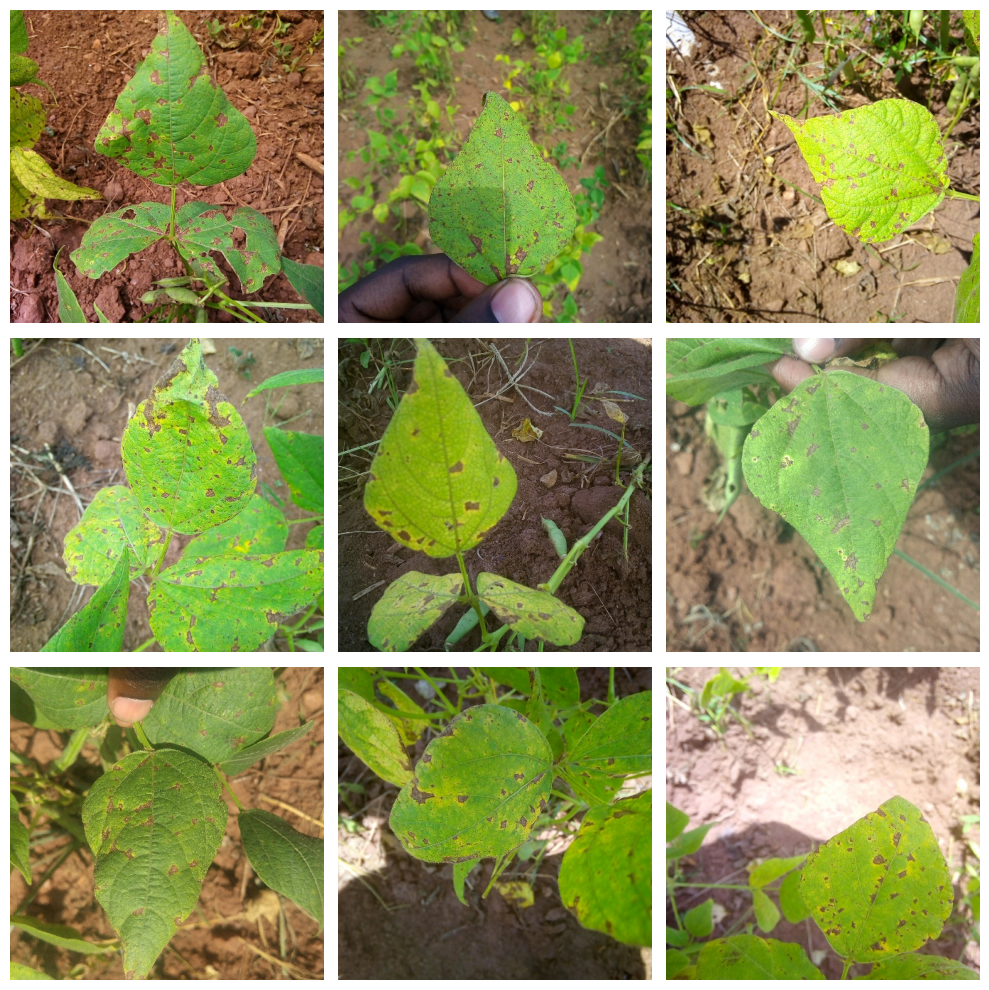

In [ ]:
fig, axes = plt.subplots(3, 3, figsize=(10, 10))

# Display the images in the subplots
for i in range(3):
    for j in range(3):
        axes[i][j].imshow(test_images[i*3 + j])
        axes[i][j].set_axis_off()

# Adjust the layout of the subplots
plt.tight_layout()

# Display the figure
plt.show()

# Create model

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers

In [ ]:
model = Sequential()
model.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(64, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2))) #เพิ่ม MaxPooling เพื่อลดขนาดของ features โดยการดึงค่า matrix ที่มากที่สุด

model.add(layers.Conv2D(64, (3, 3), activation='relu'))
model.add(layers.Flatten()) #เพิ่ม Flatten Layer เพื่อแปลง feature maps ที่ได้จาก Convolutional Layers ให้กลายเป็นเวกเตอร์ (1 มิติ) เพื่อนำเข้าในเครือข่ายประสาทเทียมแบบ fully connected.
model.add(layers.Dense(64, activation='relu'))#เพิ่ม fully  connected layer
model.add(layers.Dense(3, activation='softmax'))#เพิ่ม output layer 3 class

model.compile(optimizer='adam',
             loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
             metrics=['accuracy'])
history = model.fit(train_images, train_labels, epochs=15,
                    validation_data=(validation_images, validation_labels))


Epoch 1/15
33/33 [==============================] - 4s 64ms/step - loss: 1.6047 - accuracy: 0.3956 - val_loss: 1.9213 - val_accuracy: 0.3383
Epoch 2/15
33/33 [==============================] - 2s 56ms/step - loss: 1.1065 - accuracy: 0.4400 - val_loss: 0.8549 - val_accuracy: 0.6692
Epoch 3/15
33/33 [==============================] - 3s 77ms/step - loss: 0.8192 - accuracy: 0.6518 - val_loss: 0.6547 - val_accuracy: 0.6992
Epoch 4/15
33/33 [==============================] - 2s 69ms/step - loss: 0.7051 - accuracy: 0.7118 - val_loss: 0.6672 - val_accuracy: 0.7519
Epoch 5/15
33/33 [==============================] - 2s 56ms/step - loss: 0.5761 - accuracy: 0.7727 - val_loss: 0.5761 - val_accuracy: 0.7293
Epoch 6/15
33/33 [==============================] - 2s 51ms/step - loss: 0.4506 - accuracy: 0.8211 - val_loss: 0.6474 - val_accuracy: 0.6917
Epoch 7/15
33/33 [==============================] - 2s 50ms/step - loss: 0.3871 - accuracy: 0.8540 - val_loss: 0.7555 - val_accuracy: 0.6917
Epoch 8/15
33

In [ ]:
print(model.summary())

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_5 (Conv2D)           (None, 222, 222, 32)      896       
                                                                 
 max_pooling2d_5 (MaxPoolin  (None, 111, 111, 32)      0         
 g2D)                                                            
                                                                 
 conv2d_6 (Conv2D)           (None, 109, 109, 64)      18496     
                                                                 
 max_pooling2d_6 (MaxPoolin  (None, 54, 54, 64)        0         
 g2D)                                                            
                                                                 
 conv2d_7 (Conv2D)           (None, 52, 52, 64)        36928     
                                                                 
 flatten_1 (Flatten)         (None, 173056)           

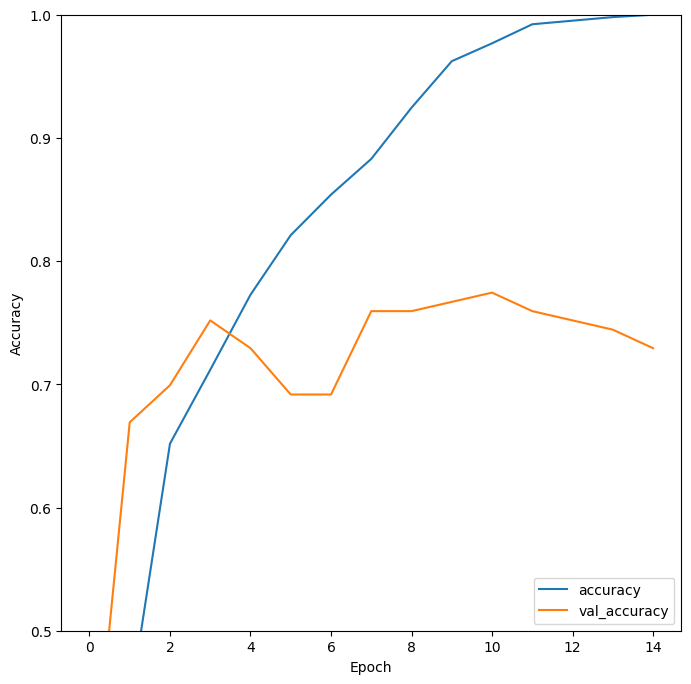

In [ ]:

plt.figure(figsize=(8, 8))
plt.plot(history.history['accuracy'], label='accuracy')
plt.plot(history.history['val_accuracy'], label = 'val_accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.ylim([0.5, 1])
plt.legend(loc='lower right')


In [ ]:
# Evaluate the model on the test data
test_loss, test_accuracy = model.evaluate(test_images, test_labels)

print(f'Test Accuracy: {test_accuracy * 100:.2f}%')


4/4 [==============================] - 0s 22ms/step - loss: 1.4609 - accuracy: 0.7109
Test Accuracy: 71.09%


In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
from sklearn.metrics import classification_report

4/4 [==============================] - 0s 19ms/step


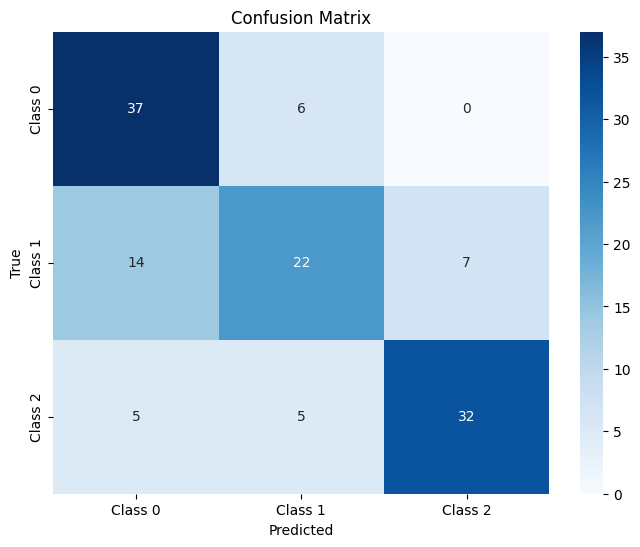

In [ ]:
# Predict on the test set
y_pred_prob = model.predict(test_images)
y_pred = np.argmax(y_pred_prob, axis=1)

# Create a confusion matrix
cm = confusion_matrix(test_labels, y_pred)

# Display the confusion matrix using a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['Class 0', 'Class 1', 'Class 2'], yticklabels=['Class 0', 'Class 1', 'Class 2'])
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()

In [ ]:
print(classification_report(test_labels, y_pred))

              precision    recall  f1-score   support

           0       0.66      0.86      0.75        43
           1       0.67      0.51      0.58        43
           2       0.82      0.76      0.79        42

    accuracy                           0.71       128
   macro avg       0.72      0.71      0.71       128
weighted avg       0.72      0.71      0.70       128



# More Layer


In [ ]:
from tensorflow.keras.models import load_model
#load model
model2 = load_model('best_beans.h5')

In [ ]:

model2 = Sequential()
model2.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)))
model2.add(layers.MaxPooling2D((2, 2)))
model2.add(layers.Conv2D(64, (3, 3), activation='relu'))
model2.add(layers.MaxPooling2D((2, 2)))
model2.add(layers.Conv2D(64, (3, 3), activation='relu'))
model2.add(layers.MaxPooling2D((2, 2)))
model2.add(layers.Conv2D(128, (3, 3), activation='relu'))
model2.add(layers.MaxPooling2D((2, 2)))
model2.add(layers.Conv2D(128, (3, 3), activation='relu'))
model2.add(layers.MaxPooling2D((2, 2)))
model2.add(layers.Flatten())
model2.add(layers.Dense(256, activation='relu'))
model2.add(layers.Dense(128, activation='relu'))
model2.add(layers.Dense(3, activation='softmax'))

model2.compile(optimizer='adam',
             loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
             metrics=['accuracy'])
history2 = model2.fit(train_images, train_labels, epochs=15,
                    validation_data=(validation_images, validation_labels))

Epoch 1/15
33/33 [==============================] - 15s 93ms/step - loss: 1.1165 - accuracy: 0.3839 - val_loss: 0.9964 - val_accuracy: 0.5940
Epoch 2/15
33/33 [==============================] - 2s 56ms/step - loss: 0.9879 - accuracy: 0.5048 - val_loss: 0.8611 - val_accuracy: 0.6090
Epoch 3/15
33/33 [==============================] - 2s 50ms/step - loss: 0.8867 - accuracy: 0.5986 - val_loss: 0.8819 - val_accuracy: 0.5414
Epoch 4/15
33/33 [==============================] - 2s 50ms/step - loss: 0.8078 - accuracy: 0.6596 - val_loss: 0.7626 - val_accuracy: 0.6391
Epoch 5/15
33/33 [==============================] - 2s 50ms/step - loss: 0.7434 - accuracy: 0.6847 - val_loss: 0.7671 - val_accuracy: 0.6541
Epoch 6/15
33/33 [==============================] - 2s 51ms/step - loss: 0.6649 - accuracy: 0.7041 - val_loss: 0.6111 - val_accuracy: 0.7368
Epoch 7/15
33/33 [==============================] - 2s 51ms/step - loss: 0.6344 - accuracy: 0.7311 - val_loss: 0.6913 - val_accuracy: 0.6842
Epoch 8/15
3

In [ ]:
print(model2.summary())

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 222, 222, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2  (None, 111, 111, 32)      0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 109, 109, 64)      18496     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 54, 54, 64)        0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 52, 52, 64)        36928     
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 26, 26, 64)        0

In [ ]:
model2.save('best_beans.h5')

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


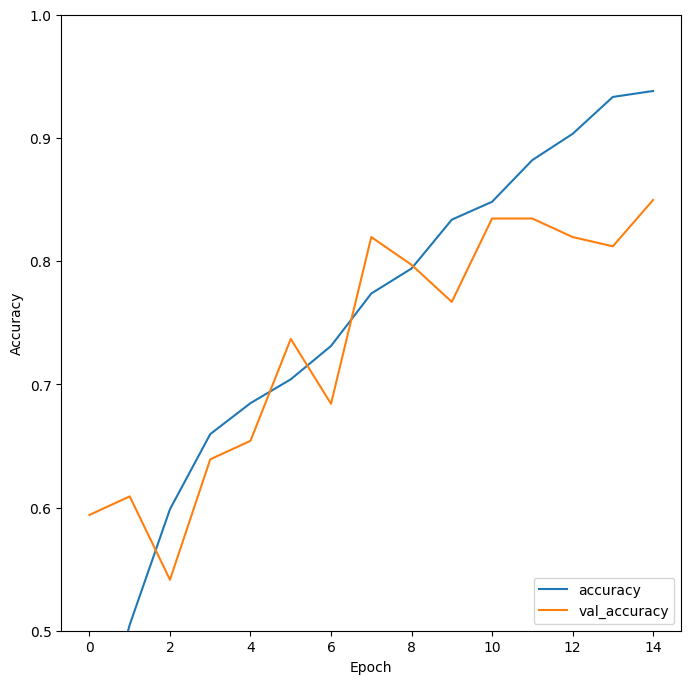

In [ ]:

plt.figure(figsize=(8, 8))
plt.plot(history2.history['accuracy'], label='accuracy')
plt.plot(history2.history['val_accuracy'], label = 'val_accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.ylim([0.5, 1])
plt.legend(loc='lower right')

In [ ]:
# Evaluate the model on the test data
test_loss, test_accuracy= model2.evaluate(test_images, test_labels)

print(f'Test Accuracy: {test_accuracy * 100:.2f}%')


4/4 [==============================] - 0s 24ms/step - loss: 0.6321 - accuracy: 0.8125
Test Accuracy: 81.25%


4/4 [==============================] - 1s 36ms/step


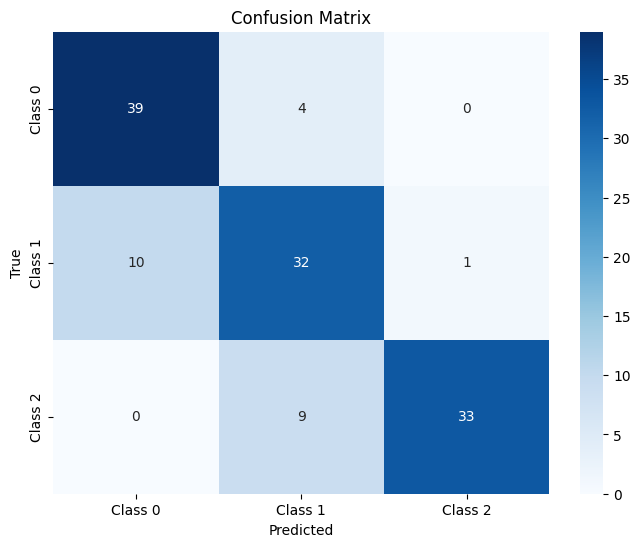

In [ ]:
# Predict on the test set
y_pred_prob = model2.predict(test_images)
y_pred = np.argmax(y_pred_prob, axis=1)

# Create a confusion matrix
cm = confusion_matrix(test_labels, y_pred)

# Display the confusion matrix using a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['Class 0', 'Class 1', 'Class 2'], yticklabels=['Class 0', 'Class 1', 'Class 2'])
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()

In [ ]:
print(classification_report(test_labels, y_pred))

              precision    recall  f1-score   support

           0       0.80      0.91      0.85        43
           1       0.71      0.74      0.73        43
           2       0.97      0.79      0.87        42

    accuracy                           0.81       128
   macro avg       0.83      0.81      0.81       128
weighted avg       0.82      0.81      0.81       128



In [ ]:
test_df['predict_prob'] = np.max(y_pred_prob, axis=1)
test_df['predicted'] = np.array(y_pred)

In [ ]:
#ตัวอย่างภาพที่ทำนายผิด
wrong0 = test_df[(test_df['label'] != test_df['predicted']) & (test_df['label'] == 0)].reset_index(drop=True)
wrong1 = test_df[(test_df['label'] != test_df['predicted']) & (test_df['label'] == 1)].reset_index(drop=True)
wrong2 = test_df[(test_df['label'] != test_df['predicted']) & (test_df['label'] == 2)].reset_index(drop=True)

In [ ]:
wrong0.sort_values('predict_prob', ascending=False, ignore_index=True)

,image,label,predict_prob,predicted
0,<PIL.JpegImagePlugin.JpegImageFile image mode=...,0,0.999069,1
1,<PIL.JpegImagePlugin.JpegImageFile image mode=...,0,0.996881,1
2,<PIL.JpegImagePlugin.JpegImageFile image mode=...,0,0.940467,1
3,<PIL.JpegImagePlugin.JpegImageFile image mode=...,0,0.736013,1


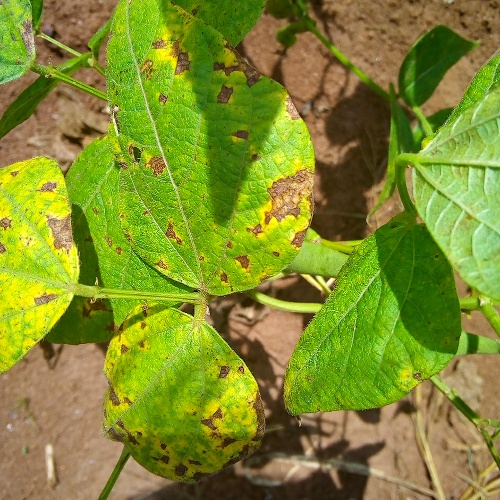

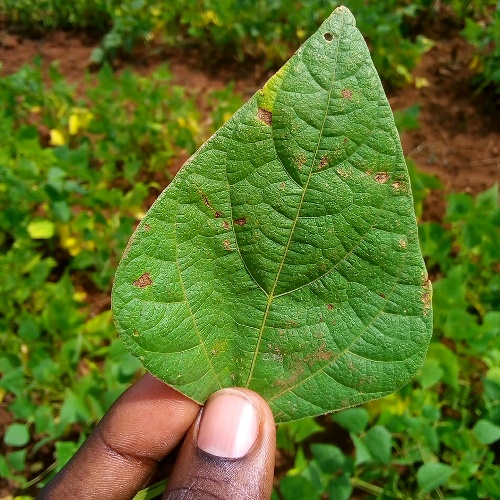

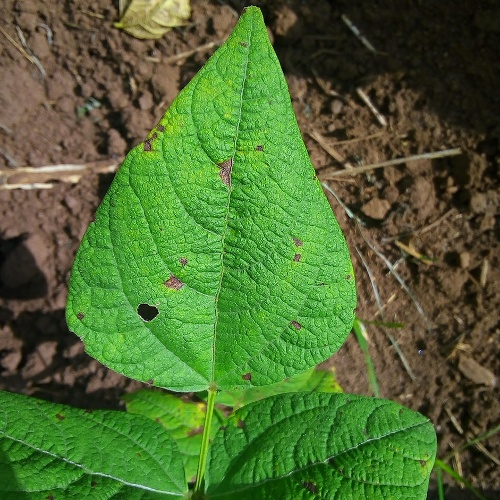

In [ ]:
for img in wrong0['image'][0:3]:
  display(img)

In [ ]:
wrong1.sort_values('predict_prob', ascending=False, ignore_index=True)

,image,label,predict_prob,predicted
0,<PIL.JpegImagePlugin.JpegImageFile image mode=...,1,0.994837,2
1,<PIL.JpegImagePlugin.JpegImageFile image mode=...,1,0.985807,0
2,<PIL.JpegImagePlugin.JpegImageFile image mode=...,1,0.926970,0
3,<PIL.JpegImagePlugin.JpegImageFile image mode=...,1,0.788293,0
4,<PIL.JpegImagePlugin.JpegImageFile image mode=...,1,0.743887,0
5,<PIL.JpegImagePlugin.JpegImageFile image mode=...,1,0.634297,0
6,<PIL.JpegImagePlugin.JpegImageFile image mode=...,1,0.578762,0
7,<PIL.JpegImagePlugin.JpegImageFile image mode=...,1,0.565622,0
8,<PIL.JpegImagePlugin.JpegImageFile image mode=...,1,0.558119,0
9,<PIL.JpegImagePlugin.JpegImageFile image mode=...,1,0.555903,0


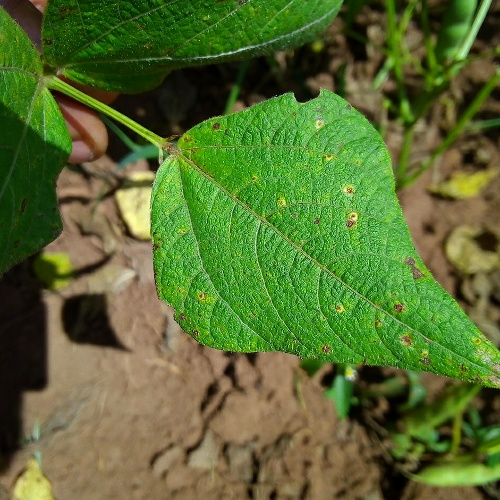

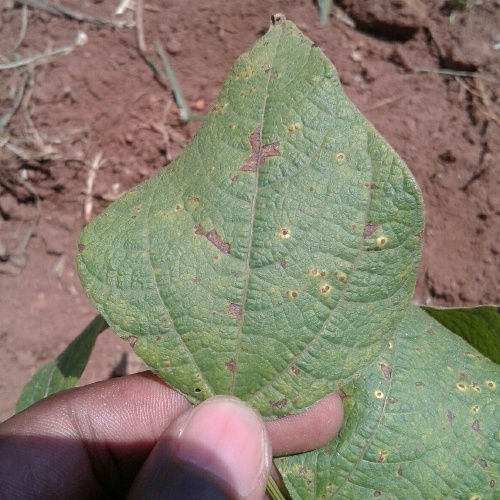

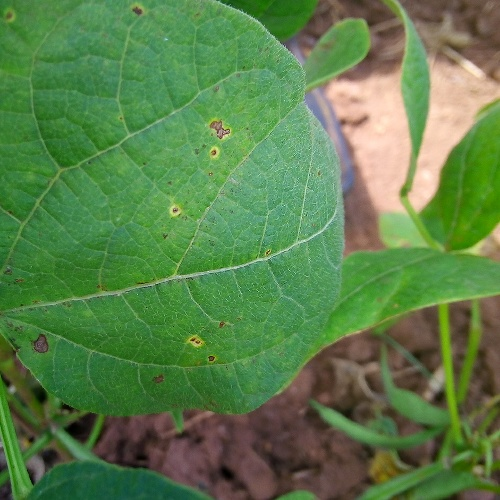

In [ ]:
for img in wrong1['image'][0:3]:
  display(img)

In [ ]:
wrong2.sort_values('predict_prob', ascending=False, ignore_index=True)

,image,label,predict_prob,predicted
0,<PIL.JpegImagePlugin.JpegImageFile image mode=...,2,0.999920,1
1,<PIL.JpegImagePlugin.JpegImageFile image mode=...,2,0.999516,1
2,<PIL.JpegImagePlugin.JpegImageFile image mode=...,2,0.971961,1
3,<PIL.JpegImagePlugin.JpegImageFile image mode=...,2,0.950067,1
4,<PIL.JpegImagePlugin.JpegImageFile image mode=...,2,0.868407,1
5,<PIL.JpegImagePlugin.JpegImageFile image mode=...,2,0.777174,1
6,<PIL.JpegImagePlugin.JpegImageFile image mode=...,2,0.726373,1
7,<PIL.JpegImagePlugin.JpegImageFile image mode=...,2,0.722120,1
8,<PIL.JpegImagePlugin.JpegImageFile image mode=...,2,0.627565,1


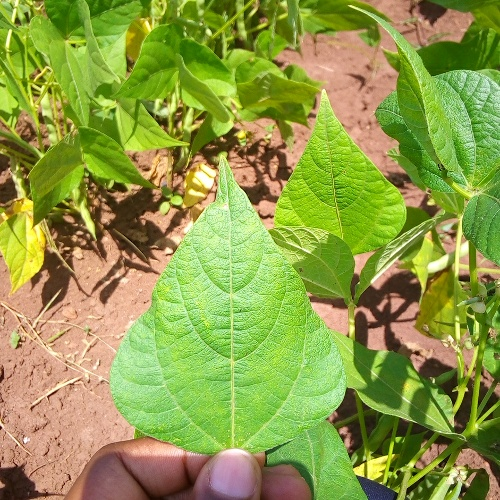

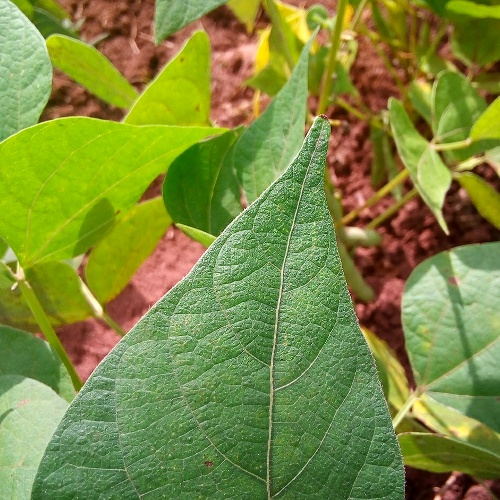

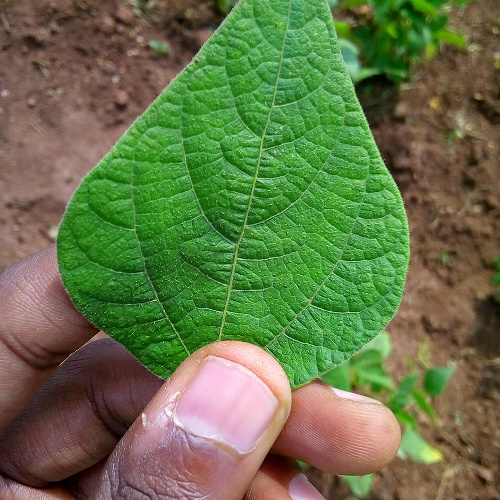

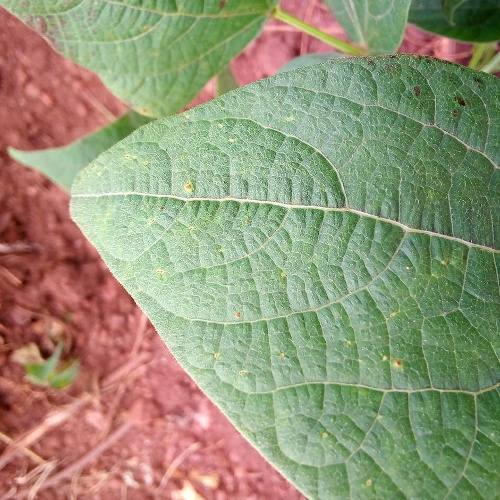

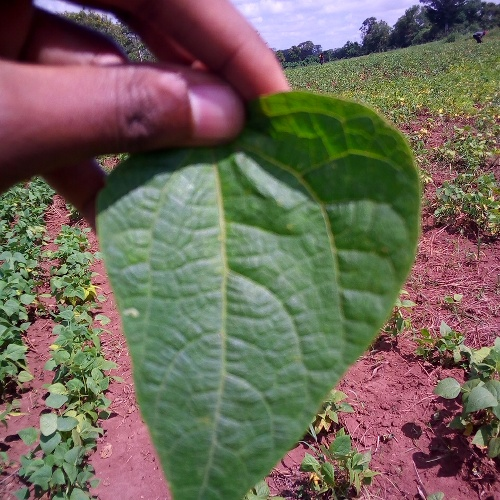

In [ ]:
for img in wrong2['image'][0:5]:
  display(img)

# Demo
https://a8cfe31330eb9abfd7.gradio.live (No longer exists)

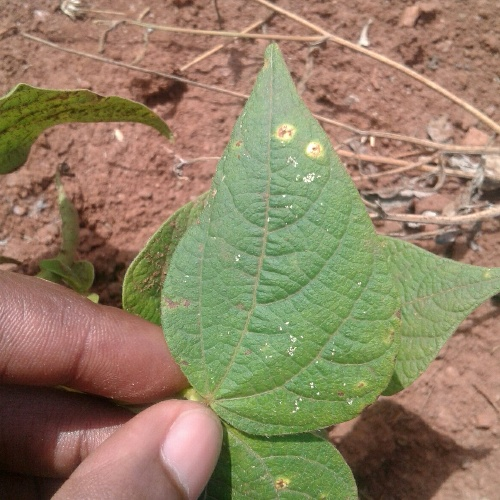